### Magics

In [84]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

### Imports

In [85]:
# System stuff
import io

# Use pathlib
from pathlib import Path

# We will oad images using PIL
from PIL import Image as PILImage

# We will use numpy for numerical operations, other numerical librarie are also needed
import numpy as np
from scipy import ndimage
from skimage.transform import resize
from scipy.signal import find_peaks

# We need some image processing stuff
from skimage.morphology import dilation, disk

# We will use matplotlib for plotting
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches
from matplotlib.colors import to_rgba

# We will use tqdm for progress bars
from tqdm.notebook import tqdm
from IPython.display import display, clear_output

# We will use joblib for parallel processing
from joblib import Parallel, delayed

# We will also use plotly for plotting
import plotly.express as px
import plotly.graph_objects as go

# We will use torch, transformers and qwen_vl_utils for the model
import torch as tt
from transformers import AutoProcessor, Qwen2_5_VLForConditionalGeneration
from qwen_vl_utils import process_vision_info

# panda and friends
import pandas as pd
import geopandas as gpd
import geodatasets
from shapely.geometry import Point

# Need regex
import re

# Finally our own stuff
from parameters import *

### Parameters

Where are th eraw tables as scanned from the book

In [3]:
raw_tables_dir = Path('../data/raw/')

The scanning was sufficiently precisly done so that we can split the pages just using a columns coordinate

In [4]:
raw_table_rough_center_column = 2000

We will use morphology to spruce up the text a bit, set parameters here

In [5]:
SELEM_SIZE = 1.5

Surprisingly, it helps to upscale the images a bit for the model to read them...

In [6]:
inference_scale_factor = 2

### Take a look at raw tables as scanned

In [7]:
#raw_tables = sorted(raw_tables_dir.glob('*.tif'))[:20]
raw_tables = sorted(raw_tables_dir.glob('*.tif'))

In [8]:
raw_tables[:20]

[PosixPath('../data/raw/table_001.tif'),
 PosixPath('../data/raw/table_002.tif'),
 PosixPath('../data/raw/table_003.tif'),
 PosixPath('../data/raw/table_004.tif'),
 PosixPath('../data/raw/table_005.tif'),
 PosixPath('../data/raw/table_006.tif'),
 PosixPath('../data/raw/table_007.tif'),
 PosixPath('../data/raw/table_008.tif'),
 PosixPath('../data/raw/table_009.tif'),
 PosixPath('../data/raw/table_010.tif'),
 PosixPath('../data/raw/table_011.tif'),
 PosixPath('../data/raw/table_012.tif'),
 PosixPath('../data/raw/table_013.tif'),
 PosixPath('../data/raw/table_014.tif'),
 PosixPath('../data/raw/table_015.tif'),
 PosixPath('../data/raw/table_016.tif'),
 PosixPath('../data/raw/table_017.tif'),
 PosixPath('../data/raw/table_018.tif'),
 PosixPath('../data/raw/table_019.tif'),
 PosixPath('../data/raw/table_020.tif')]

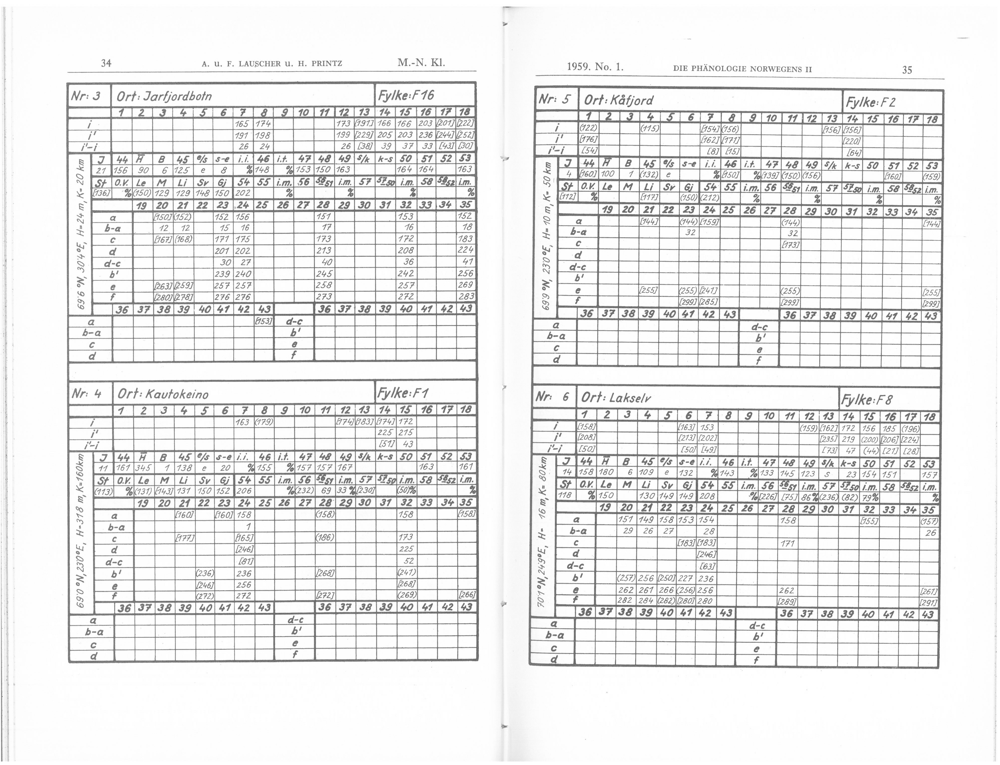

In [9]:
PILImage.open(raw_tables[1])

### Begin by splitting the pages by "brute forcing"

In this process, also strip off some of the white space and convert the images to numpy arrays.  Since the first page contains only one table (the right page), we handle this separately.

In [10]:
strip_top_N = 300
strip_bottom_N = 2750
strip_left_N = 150
strip_right_N = 1950
strip_offset = 1930
raw_table_pages = []
raw_table_pages.append(np.array(PILImage.open(raw_tables[0]).convert('L'))[strip_top_N:strip_bottom_N, 2050:(2050+1800)])
for idx in range(1, len(raw_tables)):
    raw_table_page = np.array(PILImage.open(raw_tables[idx]).convert('L'))
    raw_table_page = raw_table_page.astype(np.float32)
    raw_table_pages.append(raw_table_page[strip_top_N:strip_bottom_N, strip_left_N:strip_right_N])
    raw_table_pages.append(raw_table_page[strip_top_N:strip_bottom_N, (strip_offset + strip_left_N):(strip_offset + strip_right_N)])

Then take a look at a split page

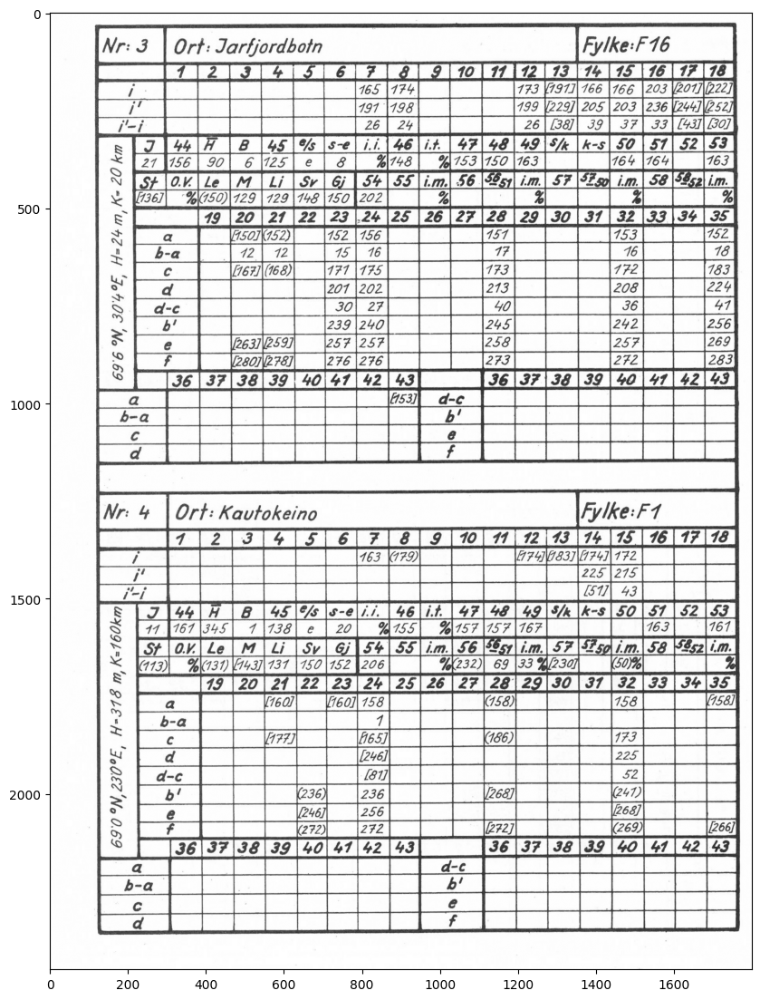

In [11]:
fig, axs = plt.subplots(1, 1, figsize=(10, 15))
axs.imshow(raw_table_pages[1], cmap='gray')
plt.show()

To make more sure this worked, take a look at some randmly selected pages...

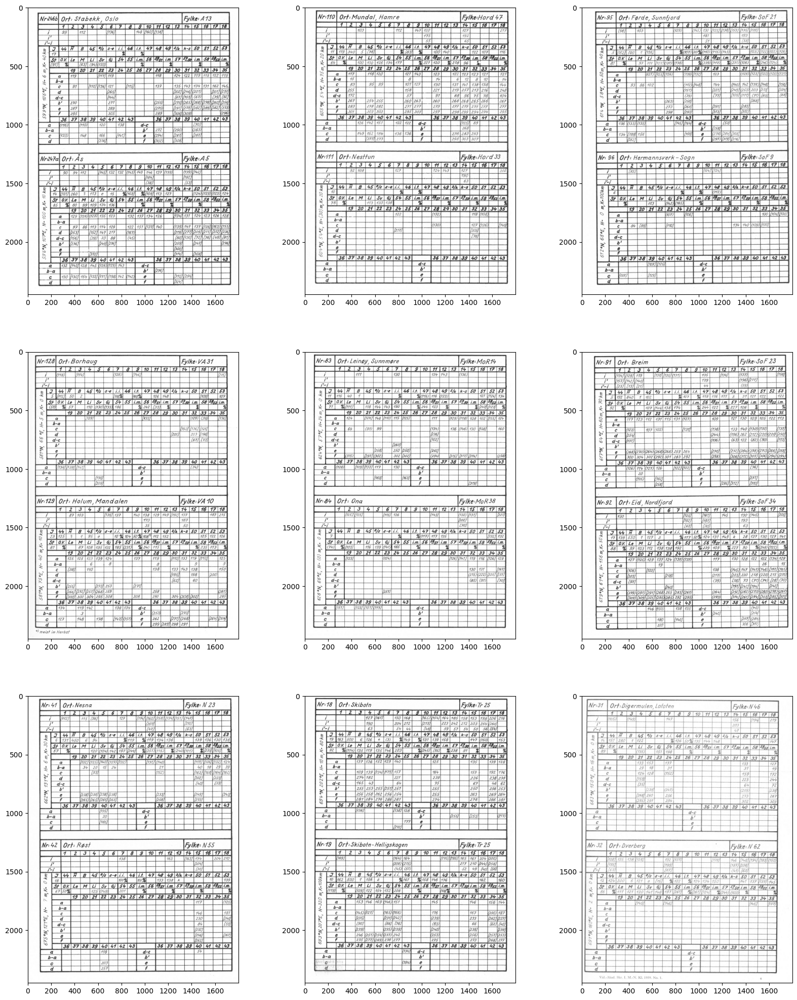

In [12]:
indexes = np.random.choice(range(len(raw_table_pages)), size=9, replace=False)
#indexes = np.arange(9)
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
axs[0, 0].imshow(raw_table_pages[indexes[0]], cmap='gray')
axs[0, 1].imshow(raw_table_pages[indexes[1]], cmap='gray')
axs[0, 2].imshow(raw_table_pages[indexes[2]], cmap='gray')
axs[1, 0].imshow(raw_table_pages[indexes[3]], cmap='gray')
axs[1, 1].imshow(raw_table_pages[indexes[4]], cmap='gray')
axs[1, 2].imshow(raw_table_pages[indexes[5]], cmap='gray')
axs[2, 0].imshow(raw_table_pages[indexes[6]], cmap='gray')
axs[2, 1].imshow(raw_table_pages[indexes[7]], cmap='gray')
axs[2, 2].imshow(raw_table_pages[indexes[8]], cmap='gray')
plt.show()


### Normalize the values in the tables

Normalize to [0.0, 1.0]

In [13]:
for idx, raw_table_page in enumerate(raw_table_pages):
    raw_table_page = raw_table_page - raw_table_page.min()
    raw_table_page = raw_table_page / raw_table_page.max()
    raw_table_pages[idx] = raw_table_page

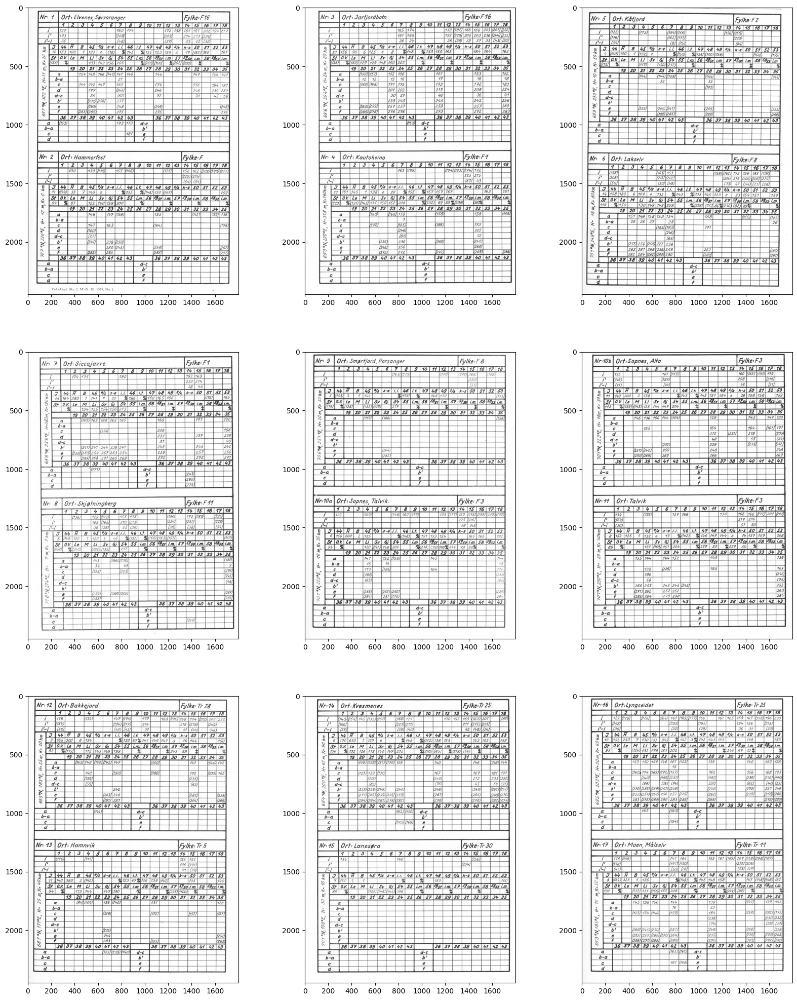

In [14]:
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
axs[0, 0].imshow(raw_table_pages[0], cmap='gray')
axs[0, 1].imshow(raw_table_pages[1], cmap='gray')
axs[0, 2].imshow(raw_table_pages[2], cmap='gray')
axs[1, 0].imshow(raw_table_pages[3], cmap='gray')
axs[1, 1].imshow(raw_table_pages[4], cmap='gray')
axs[1, 2].imshow(raw_table_pages[5], cmap='gray')
axs[2, 0].imshow(raw_table_pages[6], cmap='gray')
axs[2, 1].imshow(raw_table_pages[7], cmap='gray')
axs[2, 2].imshow(raw_table_pages[8], cmap='gray')

### Now rotate each table page to zero rotation

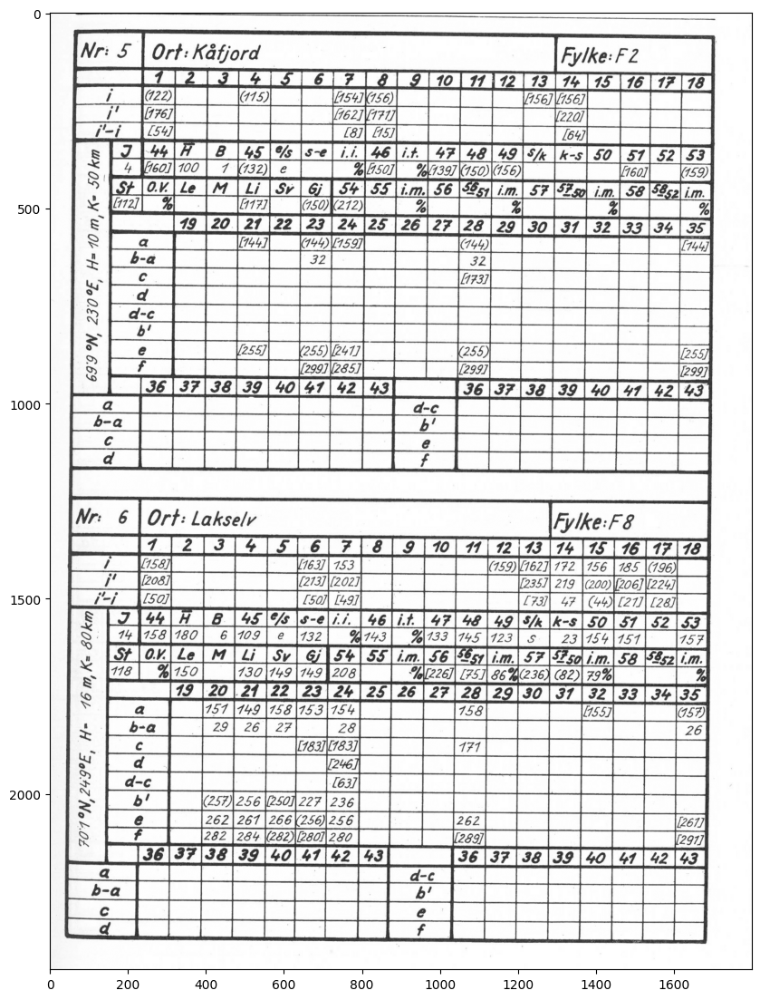

In [15]:
fig, axs = plt.subplots(1, 1, figsize=(10, 15))
axs.imshow(raw_table_pages[2], cmap='gray')
plt.show()

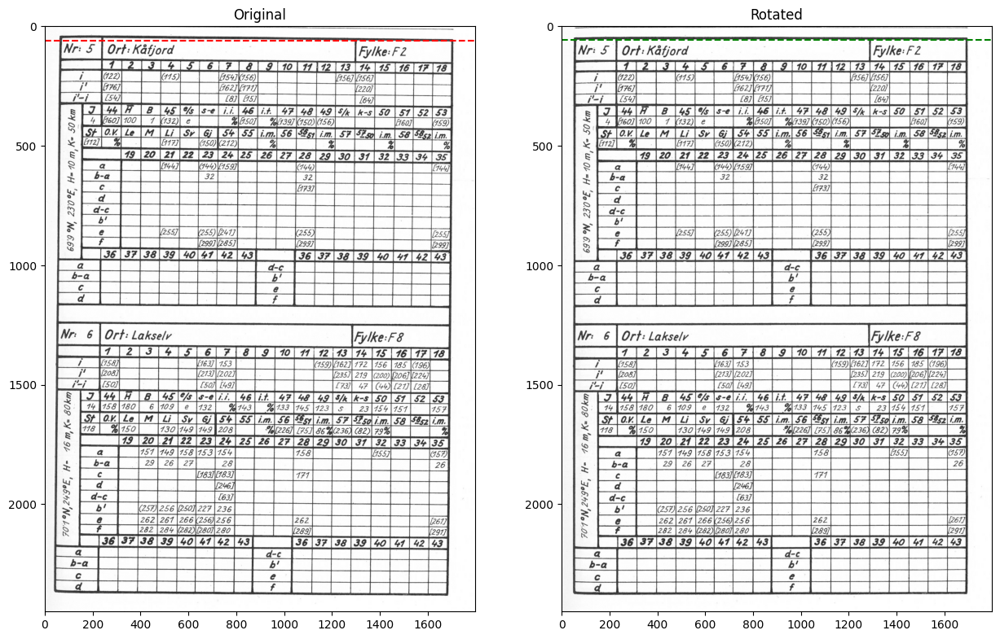

In [16]:
N = 2
max_sum_of_rows_rotation = image_rotation_analysis(raw_table_pages[N])
fig, ax = plt.subplots(1, 2, figsize=(15, 20))
ax[0].imshow(raw_table_pages[N], cmap='gray', vmin=0, vmax=1)
ax[1].imshow(ndimage.rotate(raw_table_pages[N], max_sum_of_rows_rotation, reshape=False, mode="nearest"), cmap='gray', vmin=0, vmax=1)
ax[0].set_title('Original')
ax[1].set_title('Rotated')
ax[0].axhline(y=60, color='r', linestyle='--')
ax[1].axhline(y=56, color='g', linestyle='--')
plt.show()

### Now rotate all the images

In [17]:
# First, define the process_page function
def process_page(idx, raw_table_page):
    max_sum_of_rows_rotation = image_rotation_analysis(raw_table_page)
    return idx, ndimage.rotate(raw_table_page, max_sum_of_rows_rotation, reshape=False, mode="nearest")

# Make sure the image_rotation_analysis function is also defined
# If this function is not defined, you'll need to define it as well

# Then use your parallel processing code
chunk_size = max(1, len(raw_table_pages) // 10)
chunks = np.array_split(range(len(raw_table_pages)), chunk_size)

results = []
for chunk in tqdm(chunks, desc="Processing pages in batches..."):
    chunk_results = Parallel(n_jobs=-1)(
        delayed(process_page)(idx, raw_table_pages[idx]) 
        for idx in chunk
    )
    results.extend(chunk_results)

for idx, rotated_page in results:
    raw_table_pages[idx] = rotated_page

Processing pages in batches...:   0%|          | 0/13 [00:00<?, ?it/s]

Take a look at a selection of images to check if this went well

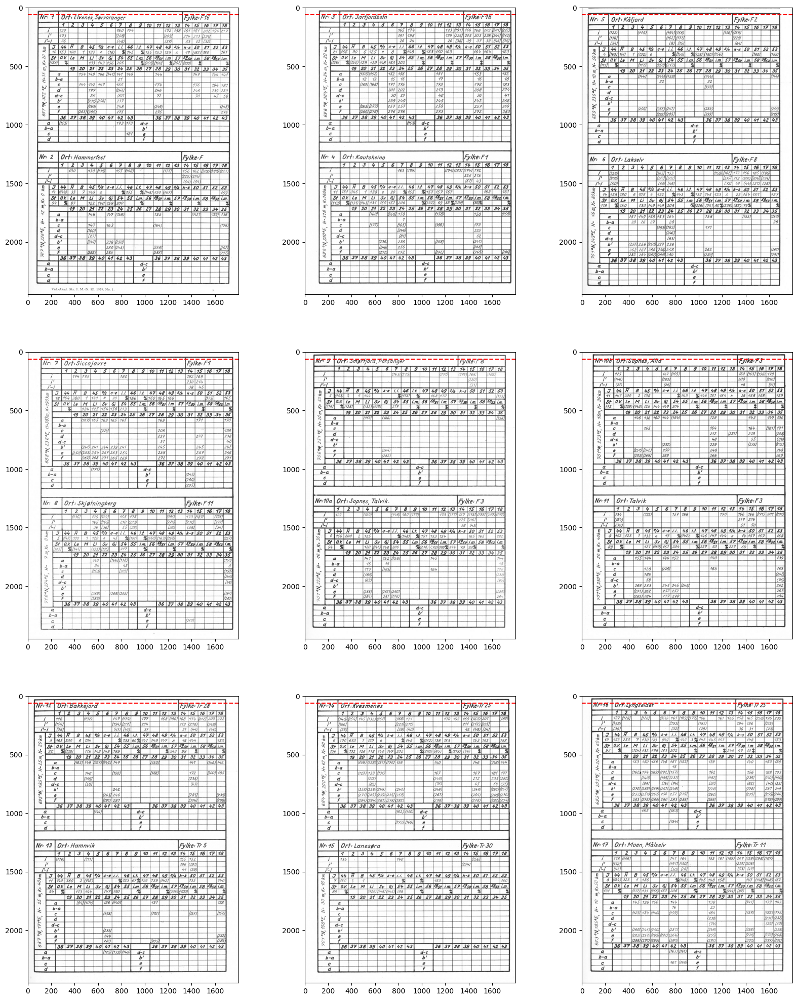

In [18]:
line_N = 60
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
axs[0, 0].imshow(raw_table_pages[0], cmap='gray', vmin=0, vmax=1)
axs[0, 0].axhline(y=line_N, color='r', linestyle='--')
axs[0, 1].imshow(raw_table_pages[1], cmap='gray', vmin=0, vmax=1)
axs[0, 1].axhline(y=line_N, color='r', linestyle='--')
axs[0, 2].imshow(raw_table_pages[2], cmap='gray', vmin=0, vmax=1)
axs[0, 2].axhline(y=line_N, color='r', linestyle='--')
axs[1, 0].imshow(raw_table_pages[3], cmap='gray', vmin=0, vmax=1)
axs[1, 0].axhline(y=line_N, color='r', linestyle='--')
axs[1, 1].imshow(raw_table_pages[4], cmap='gray', vmin=0, vmax=1)
axs[1, 1].axhline(y=line_N, color='r', linestyle='--')
axs[1, 2].imshow(raw_table_pages[5], cmap='gray', vmin=0, vmax=1)
axs[1, 2].axhline(y=line_N, color='r', linestyle='--')
axs[2, 0].imshow(raw_table_pages[6], cmap='gray', vmin=0, vmax=1)
axs[2, 0].axhline(y=line_N, color='r', linestyle='--')
axs[2, 1].imshow(raw_table_pages[7], cmap='gray', vmin=0, vmax=1)
axs[2, 1].axhline(y=line_N, color='r', linestyle='--')
axs[2, 2].imshow(raw_table_pages[8], cmap='gray', vmin=0, vmax=1)
axs[2, 2].axhline(y=line_N, color='r', linestyle='--')
plt.show()


### Then we need to crop...start by the upper left corner

Using the summation trick from above, find the upper left corner of each table and crop that corner...

In [19]:
def plot_projections(image, figsize_v=(12, 15), figsize_h=(15, 10)):
    h_proj = np.sum(1 - image, axis=1)
    v_proj = np.sum(1 - image, axis=0)
    height, width = image.shape
    
    #-----------------------------------
    # 1. VERTICAL PROJECTION
    #-----------------------------------
    fig1, (ax_vproj, ax_img) = plt.subplots(
        2, 1, figsize=figsize_v, gridspec_kw={'height_ratios': [1, 5]}, sharex=True
    )
    
    ax_vproj.plot(np.arange(width), v_proj, 'b-')
    ax_vproj.set_xlim(0, width)
    ax_vproj.set_ylabel('Sum')
    ax_vproj.set_title('Vertical Pixel Sums')
    ax_vproj.grid(True)
    
    ax_img.imshow(image, cmap='gray', aspect='auto', extent=[0, width, height, 0])
    ax_img.set_title('Document')

    #-----------------------------------
    # 2. HORIZONTAL PROJECTION
    #-----------------------------------
    fig2, (ax_img2, ax_hproj) = plt.subplots(
        1, 2, figsize=figsize_h, gridspec_kw={'width_ratios': [5, 1]}, sharey=True
    )
    
    ax_img2.imshow(image, cmap='gray', aspect='auto', extent=[0, width, height, 0])
    ax_img2.set_title('Document')

    ax_hproj.plot(h_proj, np.arange(height), 'r-')
    ax_hproj.set_ylim(height, 0)  # flip the y-axis here, instead of the image
    ax_hproj.set_xlabel('Sum')
    ax_hproj.set_title('Horizontal Pixel Sums')
    ax_hproj.grid(True)

    fig1.tight_layout()
    fig2.tight_layout()

    return fig1, fig2, h_proj, v_proj

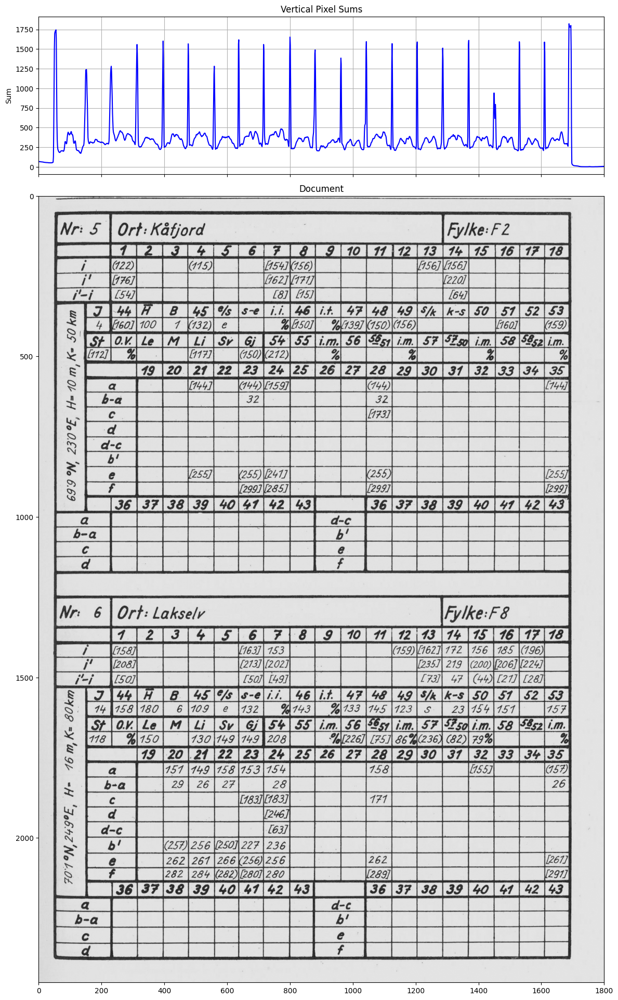

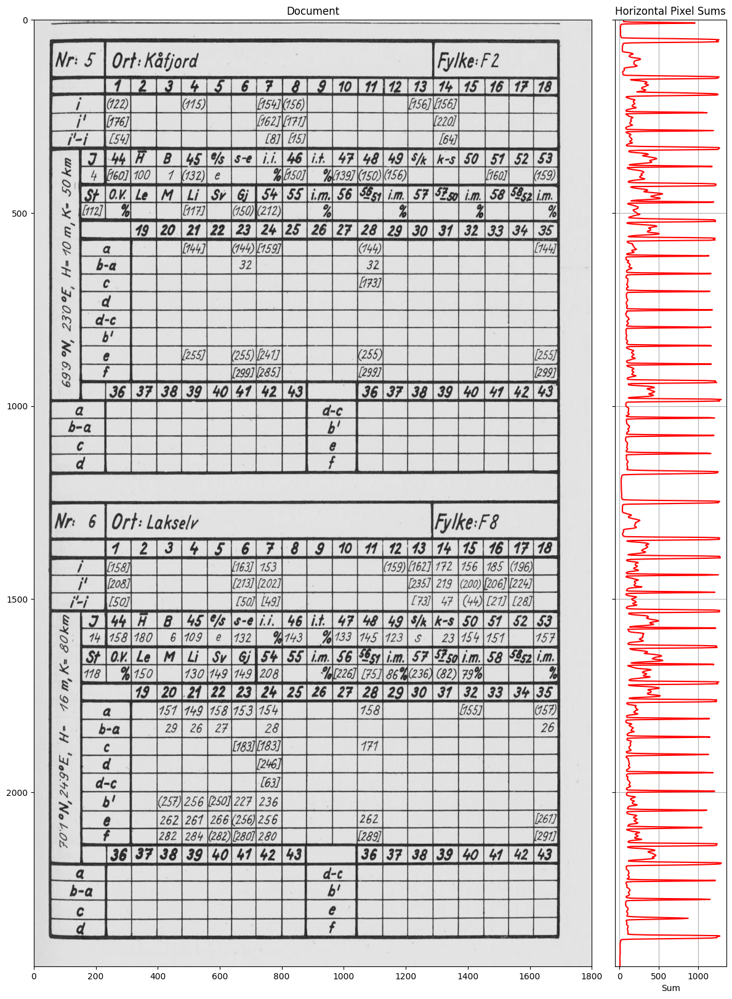

In [20]:
N = 2
height, width = raw_table_pages[N].shape
aspect_ratio = width / height

figsize_v = (12, 12/aspect_ratio + 3)
figsize_h = (12, 12/aspect_ratio)

fig_vert, fig_horz, h_proj, v_proj = plot_projections(
    raw_table_pages[N], 
    figsize_v=figsize_v,
    figsize_h=figsize_h
)

plt.show()

In [21]:
peaks_h, _ = find_peaks(h_proj, height=700, distance=50)
peaks_v, _ = find_peaks(v_proj, height=700, distance=50)

In [22]:
peaks_h

array([  52,  148,  241,  332,  426,  522,  657,  751,  844,  983, 1076,
       1170, 1247, 1341, 1393, 1529, 1625, 1714, 1765, 1857, 1997, 2133,
       2183, 2277, 2372])

In [23]:
peaks_v

array([  55,  152,  231,  313,  396,  476,  559,  637,  716,  800,  880,
        962, 1043, 1125, 1205, 1286, 1369, 1449, 1530, 1610, 1688])

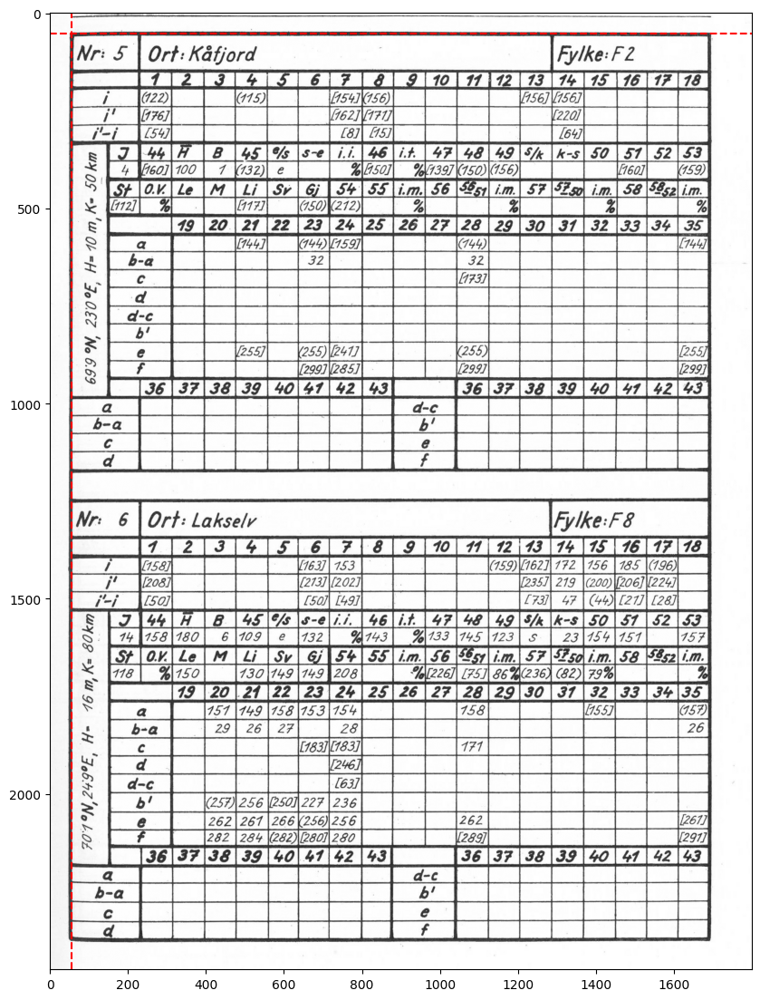

In [24]:
fig, ax = plt.subplots(1, 1, figsize=(10, 15))
ax.imshow(raw_table_pages[N], cmap='gray', vmin=0, vmax=1)
ax.axhline(y=peaks_h[0], color='r', linestyle='--')
ax.axvline(x=peaks_v[0], color='r', linestyle='--')
plt.show()

In [25]:
def find_table_corners(image):
    h_proj = np.sum(1 - image, axis=1)
    v_proj = np.sum(1 - image, axis=0)
    peaks_h, _ = find_peaks(h_proj, height=700, distance=50)
    peaks_v, _ = find_peaks(v_proj, height=700, distance=50)
    ul_corner = (peaks_v[0], peaks_h[0])
    lr_corner = (peaks_v[-1], peaks_h[-1])
    return ul_corner, lr_corner, peaks_h, peaks_v

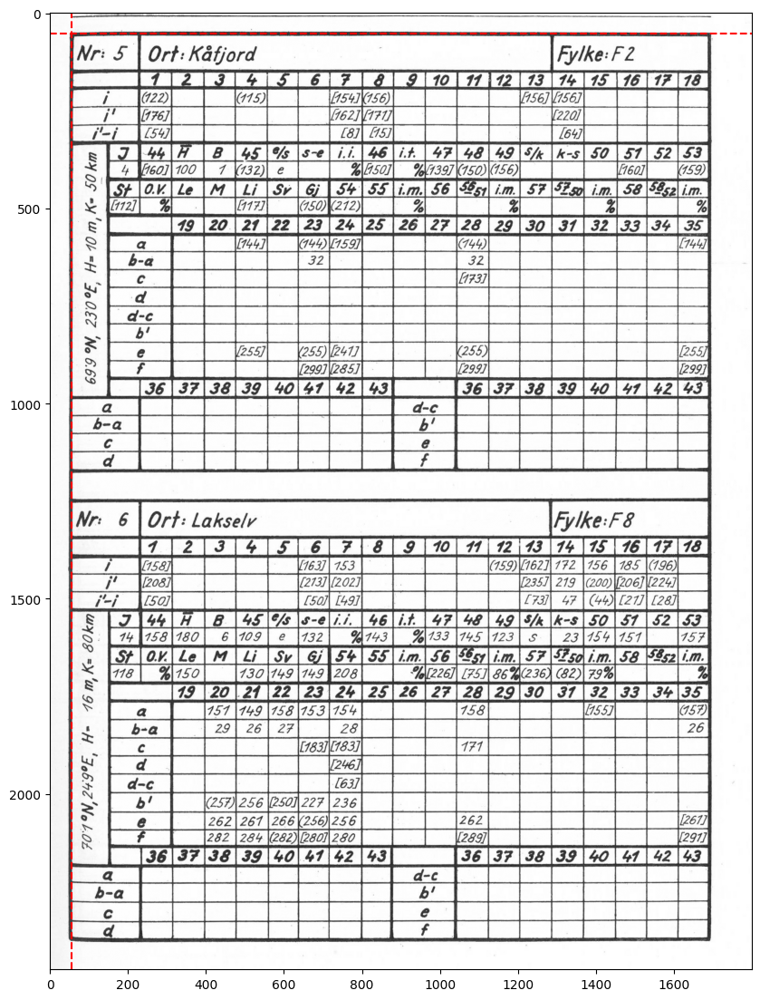

In [26]:
ul_corner, _, peaks_h, peaks_v = find_table_corners(raw_table_pages[N])
fig, ax = plt.subplots(1, 1, figsize=(10, 15))
ax.imshow(raw_table_pages[N], cmap='gray', vmin=0, vmax=1)
ax.axhline(y=ul_corner[1], color='r', linestyle='--')
ax.axvline(x=ul_corner[0], color='r', linestyle='--')
plt.show()

In [27]:
raw_table_pages_cropped = []
for idx, raw_table_page in enumerate(raw_table_pages):
    ul_corner, lr_corner, peaks_h, peaks_v = find_table_corners(raw_table_page)
    raw_table_pages_cropped.append(raw_table_page[ul_corner[1]:lr_corner[1], ul_corner[0]:lr_corner[0]])

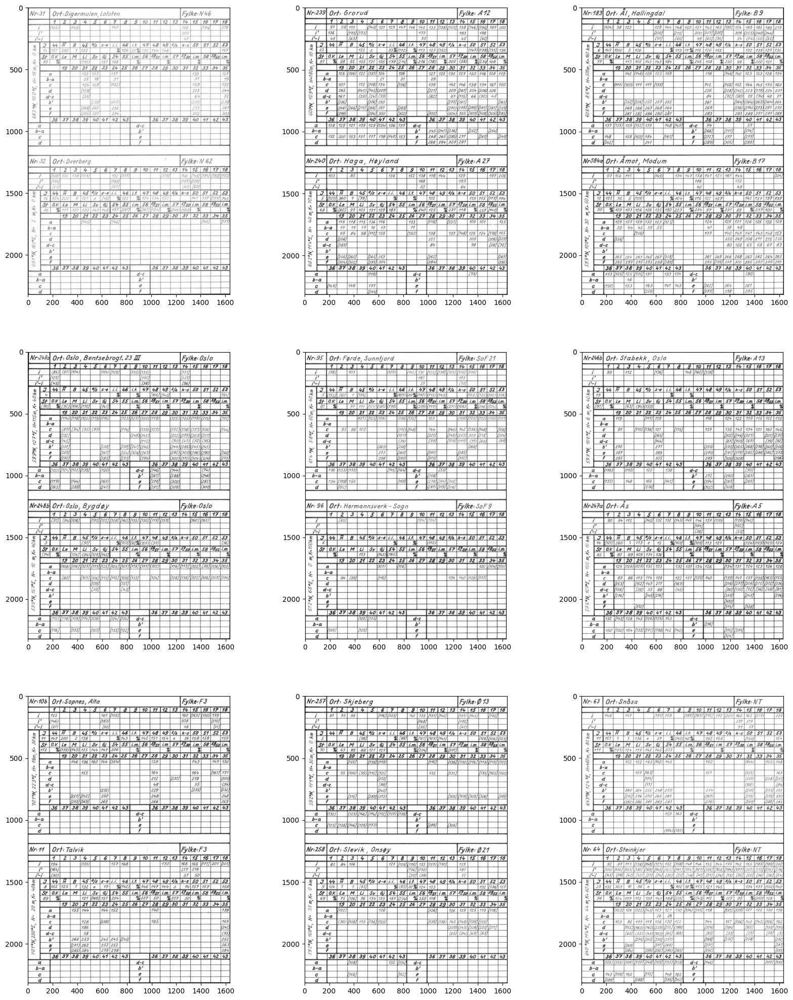

In [28]:
indexes = np.random.choice(range(len(raw_table_pages)), size=9, replace=False)
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
axs[0, 0].imshow(raw_table_pages_cropped[indexes[0]], cmap='gray', vmin=0, vmax=1)
axs[0, 1].imshow(raw_table_pages_cropped[indexes[1]], cmap='gray', vmin=0, vmax=1)
axs[0, 2].imshow(raw_table_pages_cropped[indexes[2]], cmap='gray', vmin=0, vmax=1)
axs[1, 0].imshow(raw_table_pages_cropped[indexes[3]], cmap='gray', vmin=0, vmax=1)
axs[1, 1].imshow(raw_table_pages_cropped[indexes[4]], cmap='gray', vmin=0, vmax=1)
axs[1, 2].imshow(raw_table_pages_cropped[indexes[5]], cmap='gray', vmin=0, vmax=1)
axs[2, 0].imshow(raw_table_pages_cropped[indexes[6]], cmap='gray', vmin=0, vmax=1)
axs[2, 1].imshow(raw_table_pages_cropped[indexes[7]], cmap='gray', vmin=0, vmax=1)
axs[2, 2].imshow(raw_table_pages_cropped[indexes[8]], cmap='gray', vmin=0, vmax=1)
plt.show()

### Then we rescale the images to the same size

In [29]:
mean_height = np.mean([raw_table_page.shape[0] for raw_table_page in raw_table_pages_cropped])
mean_width = np.mean([raw_table_page.shape[1] for raw_table_page in raw_table_pages_cropped])
raw_table_pages_cropped_resized = []
for idx, raw_table_page in enumerate(raw_table_pages_cropped):
    raw_table_pages_cropped_resized.append(resize(raw_table_page, (mean_height, mean_width), anti_aliasing=True))

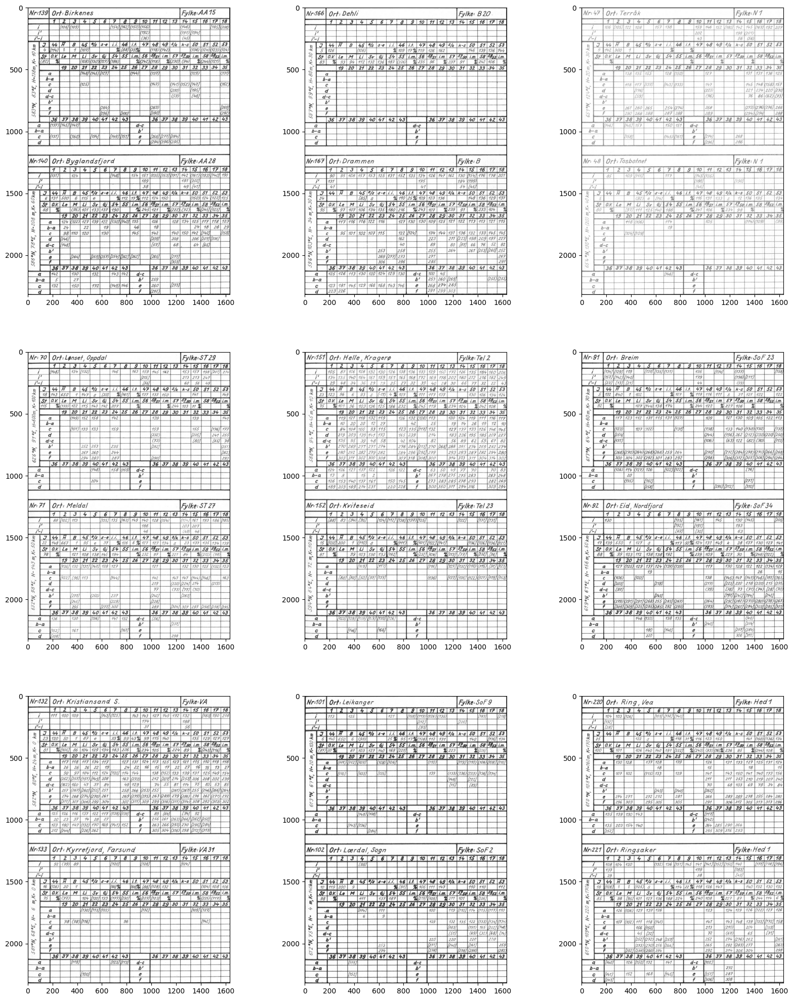

In [30]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
axs[0, 0].imshow(raw_table_pages_cropped_resized[indexes[0]], cmap='gray', vmin=0, vmax=1)
axs[0, 1].imshow(raw_table_pages_cropped_resized[indexes[1]], cmap='gray', vmin=0, vmax=1)
axs[0, 2].imshow(raw_table_pages_cropped_resized[indexes[2]], cmap='gray', vmin=0, vmax=1)
axs[1, 0].imshow(raw_table_pages_cropped_resized[indexes[3]], cmap='gray', vmin=0, vmax=1)
axs[1, 1].imshow(raw_table_pages_cropped_resized[indexes[4]], cmap='gray', vmin=0, vmax=1)
axs[1, 2].imshow(raw_table_pages_cropped_resized[indexes[5]], cmap='gray', vmin=0, vmax=1)
axs[2, 0].imshow(raw_table_pages_cropped_resized[indexes[6]], cmap='gray', vmin=0, vmax=1)
axs[2, 1].imshow(raw_table_pages_cropped_resized[indexes[7]], cmap='gray', vmin=0, vmax=1)
axs[2, 2].imshow(raw_table_pages_cropped_resized[indexes[8]], cmap='gray', vmin=0, vmax=1)
plt.show()

### Finally get the unique tables

In [31]:
tables = []
for page in raw_table_pages_cropped_resized:
    upper_table = page[0:1120, :]
    lower_table = page[1200:, :]
    tables.append(upper_table)
    tables.append(lower_table)

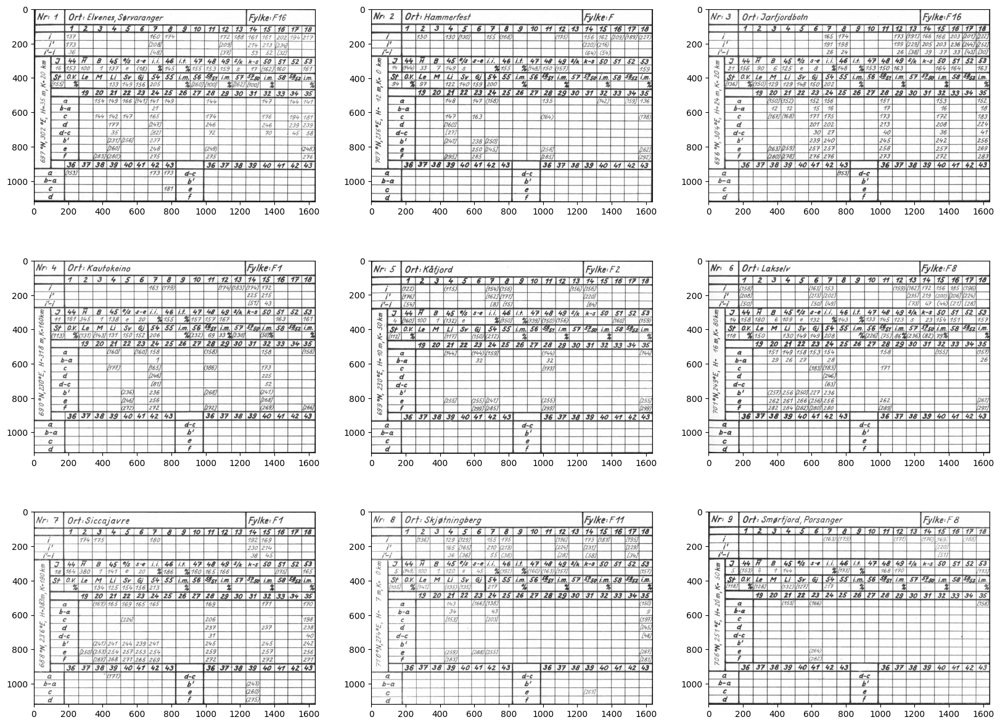

In [32]:
#indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
indexes = np.arange(9)
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
axs[0, 0].imshow(tables[indexes[0]], cmap='gray', vmin=0, vmax=1)
axs[0, 1].imshow(tables[indexes[1]], cmap='gray', vmin=0, vmax=1)
axs[0, 2].imshow(tables[indexes[2]], cmap='gray', vmin=0, vmax=1)
axs[1, 0].imshow(tables[indexes[3]], cmap='gray', vmin=0, vmax=1)
axs[1, 1].imshow(tables[indexes[4]], cmap='gray', vmin=0, vmax=1)
axs[1, 2].imshow(tables[indexes[5]], cmap='gray', vmin=0, vmax=1)
axs[2, 0].imshow(tables[indexes[6]], cmap='gray', vmin=0, vmax=1)
axs[2, 1].imshow(tables[indexes[7]], cmap='gray', vmin=0, vmax=1)
axs[2, 2].imshow(tables[indexes[8]], cmap='gray', vmin=0, vmax=1)
plt.show()

### Let's try and get a specific cell from all the images...

Let's get the 'Motacilla alba' cell

In [33]:
species_phases_dicts = generate_species_phase_dicts(species_list)

In [34]:
species_phases_dicts['coltsfoot_flowering']

{'norwegian_name': 'Hestehov',
 'english_name': 'Coltsfoot',
 'latin_name': 'Tussilago farfara',
 'phase': 'flowering',
 'row_start_idx': 2,
 'row_end_idx': 3,
 'col_start_idx': 2,
 'col_end_idx': 3}

In [35]:
species_phases_dicts['coltsfoot_fruit']

{'norwegian_name': 'Hestehov',
 'english_name': 'Coltsfoot',
 'latin_name': 'Tussilago farfara',
 'phase': 'fruit',
 'row_start_idx': 3,
 'row_end_idx': 4,
 'col_start_idx': 2,
 'col_end_idx': 3}

In [36]:
species_phases_dicts['coltsfoot_timespan']

{'norwegian_name': 'Hestehov',
 'english_name': 'Coltsfoot',
 'latin_name': 'Tussilago farfara',
 'phase': 'timespan',
 'row_start_idx': 4,
 'row_end_idx': 5,
 'col_start_idx': 2,
 'col_end_idx': 3}

In [37]:
species_phases_dicts['pine_greenup']

{'norwegian_name': 'Furu',
 'english_name': 'Pine',
 'latin_name': 'Pinus sylvestris',
 'phase': 'greenup',
 'row_start_idx': 19,
 'row_end_idx': 20,
 'col_start_idx': 9,
 'col_end_idx': 10}

In [38]:
species_phases_dicts['first_observation_of_wagtail']

{'norwegian_name': 'Første observasjon linerle',
 'english_name': 'First observation of wagtail',
 'latin_name': '',
 'phase': None,
 'row_start_idx': 8,
 'row_end_idx': 9,
 'col_start_idx': 5,
 'col_end_idx': 6}

In [39]:
species_phases_dicts['pine_start_senescence']

{'norwegian_name': 'Furu',
 'english_name': 'Pine',
 'latin_name': 'Pinus sylvestris',
 'phase': 'start_senescence',
 'row_start_idx': 20,
 'row_end_idx': 21,
 'col_start_idx': 19,
 'col_end_idx': 20}

Just check the keys...

In [40]:
for idx, k in enumerate(species_phases_dicts.keys()):
    print(f'{idx} ---> {k}')

0 ---> number
1 ---> location
2 ---> county
3 ---> position
4 ---> hasl
5 ---> ds
6 ---> coltsfoot_flowering
7 ---> coltsfoot_fruit
8 ---> coltsfoot_timespan
9 ---> liverleaf_fruit
10 ---> liverleaf_timespan
11 ---> wood_anemone_flowering
12 ---> wood_anemone_fruit
13 ---> wood_anemone_timespan
14 ---> purple_saxifrage_flowering
15 ---> purple_saxifrage_fruit
16 ---> purple_saxifrage_timespan
17 ---> meadow_saxifrage_flowering
18 ---> meadow_saxifrage_fruit
19 ---> meadow_saxifrage_timespan
20 ---> cowslip_flowering
21 ---> cowslip_fruit
22 ---> cowslip_timespan
23 ---> marsh_marigold_flowering
24 ---> marsh_marigold_fruit
25 ---> marsh_marigold_timespan
26 ---> globeflower_flowering
27 ---> globeflower_fruit
28 ---> globeflower_timespan
29 ---> lily_of_the_valley_flowering
30 ---> lily_of_the_valley_fruit
31 ---> lily_of_the_valley_timespan
32 ---> wild_strawberry_flowering
33 ---> wild_strawberry_fruit
34 ---> wild_strawberry_timespan
35 ---> wood_sorrel_flowering
36 ---> wood_sorrel

What does the dictionary for the wagtails look like

Display it in an image

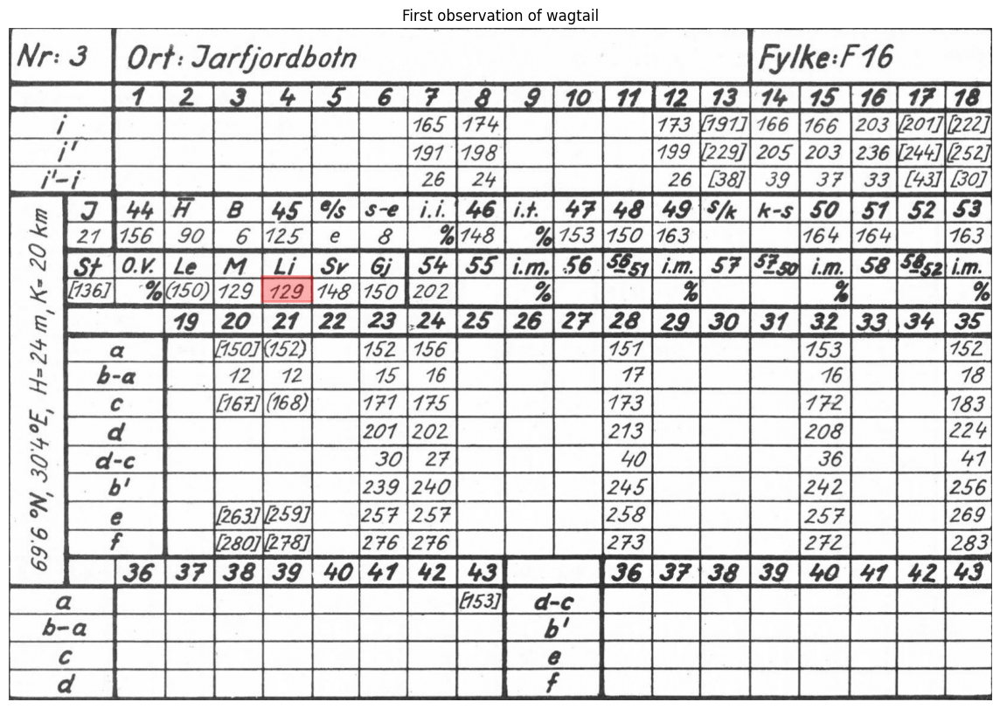

In [41]:
visualize_observation_phases(tables[N],
                             'First observation of wagtail',
                             None,
                             species_phases_dicts)

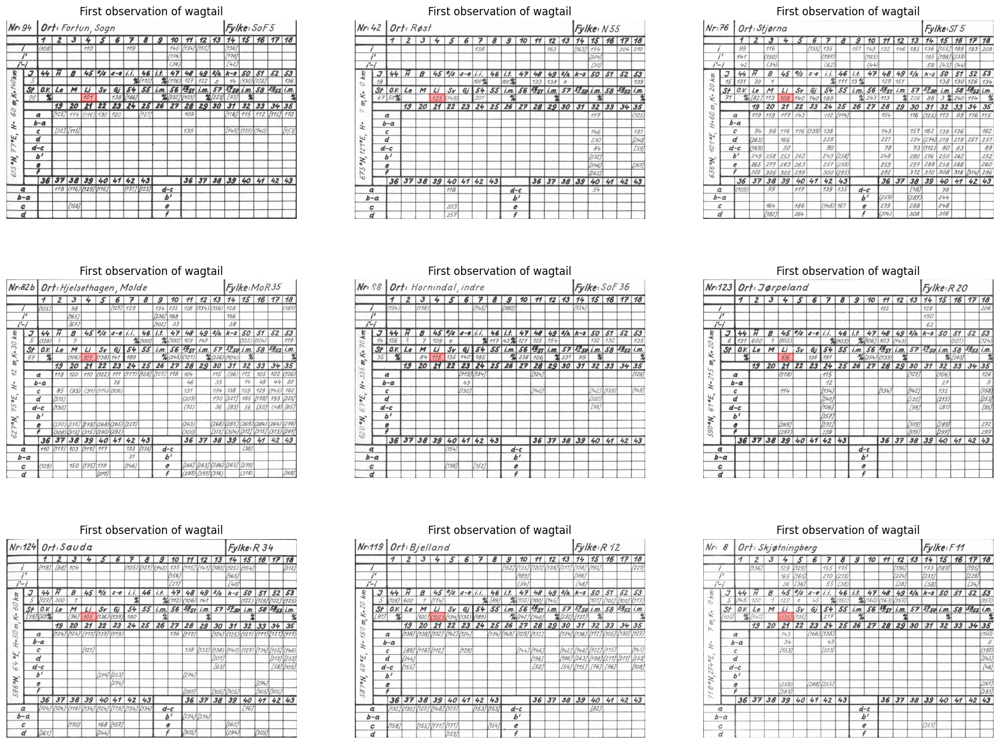

In [42]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
#indexes = np.arange(9)
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
visualize_observation_phases(tables[indexes[0]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[0, 0])
visualize_observation_phases(tables[indexes[1]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[0, 1])
visualize_observation_phases(tables[indexes[2]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[0, 2])
visualize_observation_phases(tables[indexes[3]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[1, 0])
visualize_observation_phases(tables[indexes[4]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[1, 1])
visualize_observation_phases(tables[indexes[5]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[1, 2])
visualize_observation_phases(tables[indexes[6]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[2, 0])   
visualize_observation_phases(tables[indexes[7]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[2, 1])
visualize_observation_phases(tables[indexes[8]], 'First observation of wagtail', None, species_phases_dicts, ax = axs[2, 2])

In [43]:
indexes

array([101,  43,  78,  89, 105, 131, 132, 127,   7])

In [44]:
np.max(tables[indexes[5]])

np.float32(1.0717188)

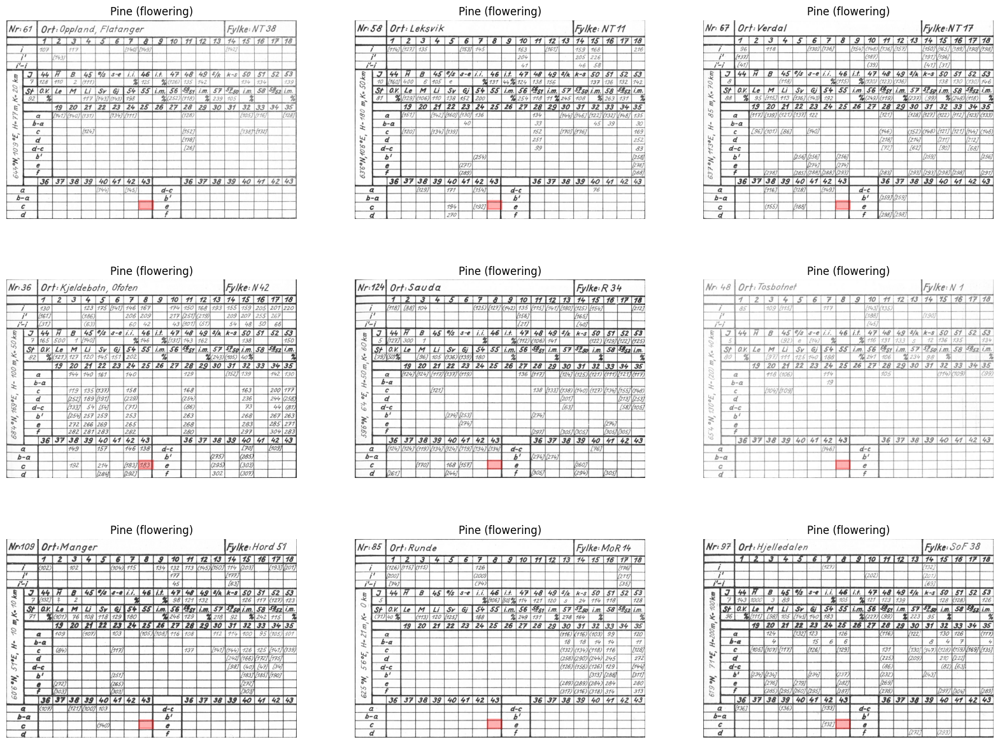

In [45]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
#indexes = np.arange(9)
phase = 'flowering'
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
visualize_observation_phases(tables[indexes[0]], 'Pine', phase, species_phases_dicts, ax = axs[0, 0])
visualize_observation_phases(tables[indexes[1]], 'Pine', phase, species_phases_dicts, ax = axs[0, 1])
visualize_observation_phases(tables[indexes[2]], 'Pine', phase, species_phases_dicts, ax = axs[0, 2])
visualize_observation_phases(tables[indexes[3]], 'Pine', phase, species_phases_dicts, ax = axs[1, 0])
visualize_observation_phases(tables[indexes[4]], 'Pine', phase, species_phases_dicts, ax = axs[1, 1])
visualize_observation_phases(tables[indexes[5]], 'Pine', phase, species_phases_dicts, ax = axs[1, 2])
visualize_observation_phases(tables[indexes[6]], 'Pine', phase, species_phases_dicts, ax = axs[2, 0])   
visualize_observation_phases(tables[indexes[7]], 'Pine', phase, species_phases_dicts, ax = axs[2, 1])
visualize_observation_phases(tables[indexes[8]], 'Pine', phase, species_phases_dicts, ax = axs[2, 2])

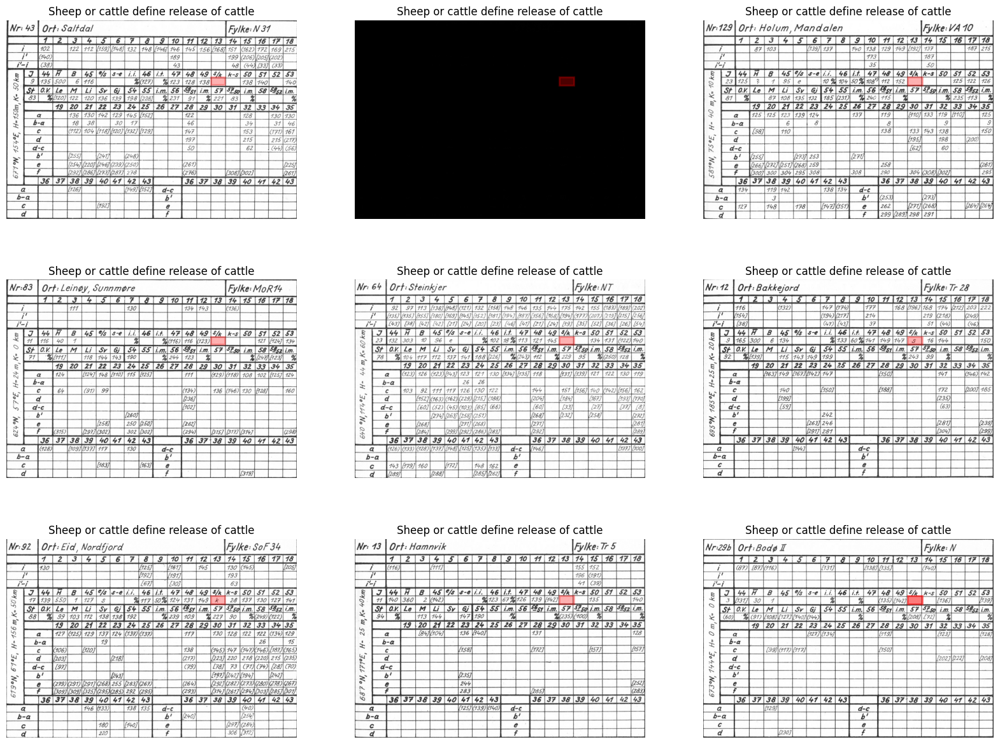

In [46]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
#indexes = np.arange(9)
phase = None
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
visualize_observation_phases(tables[indexes[0]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[0, 0])
visualize_observation_phases(tables[indexes[1]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[0, 1])
visualize_observation_phases(tables[indexes[2]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[0, 2])
visualize_observation_phases(tables[indexes[3]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[1, 0])
visualize_observation_phases(tables[indexes[4]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[1, 1])
visualize_observation_phases(tables[indexes[5]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[1, 2])
visualize_observation_phases(tables[indexes[6]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[2, 0])   
visualize_observation_phases(tables[indexes[7]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[2, 1])
visualize_observation_phases(tables[indexes[8]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[2, 2])
visualize_observation_phases(tables[indexes[8]], 'Sheep or cattle define release of cattle', phase, species_phases_dicts, ax = axs[2, 2])

### Get information more systematically...

Get table numbers

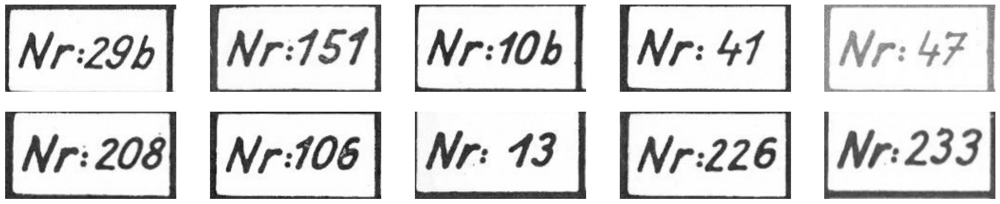

In [47]:
nr_images = show_selection(tables,
                           species_phases_dicts['number'],
                           offset = 7,
                           figsize=(25, 5),
                           rotate = False,
                           selem_size = SELEM_SIZE,
                           selection_size = 10,
                           subplot_size = (2, 5))

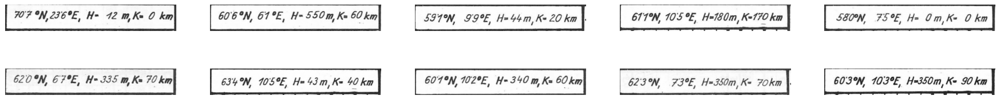

In [48]:
position_images = show_selection(tables,
                                 species_phases_dicts['position'],
                                 offset = 7,
                                 figsize=(25, 3),
                                 rotate = True,
                                 selem_size = SELEM_SIZE,
                                 selection_size = 10,
                                 subplot_size = (2, 5))

### Get ready to read the snippets

First we need to load the model

In [49]:
model_id = "Qwen/Qwen2.5-VL-7B-Instruct"

In [50]:
def get_model_and_processor(model_id, max_pixels, device='mps'):
    
    model = Qwen2_5_VLForConditionalGeneration.from_pretrained(
        model_id,
        torch_dtype=tt.bfloat16,
        device_map="auto",
        )
    model.to(device)

    # Get the processor
    processor = AutoProcessor.from_pretrained(model_id,
                                              min_pixels=max_pixels,
                                              max_pixels=max_pixels)

    return model, processor

In [51]:
model, processor = get_model_and_processor(model_id,
                                           max_pixels = 2048,
                                           device='mps')

Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


Define a system prompt

In [52]:
SYSTEM_MESSAGE_PHENOLOGY = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.

The texts can consist of the following:
1) A number only, the number can have from 1 to 3 digits.
2) A number surrounded by ordinary parenthesis.
3) A number surrounded by sqaure brackets.
5) The letter 'e'
6) The letter 'k'
7) The letter 's'
6) The percent sign '%'
7) No text at all.

Instructions:

**General Rules**:
    - Return the text as a string.
    - If the snippet contains no text, return "unknown".
    - In order to separate the digit 1 from the digit 7, know that the digit 7 always will have a horizontal stroke appearing in the middle of the digit.
      If there is no such horizontal stroke, the digit is a 1 even if it might look like a 7.
    - Beware that the text will often be surrounded by a black border, do not confuse this with the text.  In particular
      it is easy to confuse the digit 1 with parts of the border.
    - Ignore anything OUTSIDE the border.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [53]:
SYSTEM_MESSAGE_TEXT = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.

**General Rules**:
    - Return the text as a string.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [54]:
SYSTEM_MESSAGE_NUMBER = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed by
the text 'Nr:' followed by a number.  The number can have 1 to 3 digits.  At the end of the number, there
might be a letter a, b, c, d or e.

Examples:
'Nr: 2' 
or
'Nr: 123'
or
'Nr: 10a'
or
'Nr: 10b'
or
'Nr: 110d'

**General Rules**:
    - Return the entire text as a string.
    - Pay very close attention to the possibility of a letter a or b at the end of the number.  It is
      very important that you do not mistake a letter for a digit.  In particular it is easy to confuse
      the letter 'b' with the digit '6'.  Do not do that.
    - Do NOT remove the 'Nr:' part of the text.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [55]:
SYSTEM_MESSAGE_POSITION = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
a position and some more information.

The position part appears first, it will be on this format:

70'1°N, 23'10°E

Notice that this is NOT the standard format for latitude and longitude.  The standard format is:

70°1'N, 23°10'E

but this is not the format used in the table.

Be very carful not to miss the "'" symbol as it can appear small in the scanned text.

The position must be valid for mainland Norway so the minimal latitude is 57 and the maximal latitude is 71.
The minimal longitude is 4 and the maximal longitude is 31.

**General Rules**:
    - Return the text as a string.
    - Do NOT use more than TWO digits for the degrees.  If there are more than two digits, use the first two
      as degrees and the rest as minutes.
    - Pay VERY CLOSE attention to the degrees mark "'", it can be very small and look more like a dot than a "'".
    - Return the position in the standard format using degrees and  minutes represented as ° and '.
    - A typical position will look like this: 70°1'N, 23°1'E or 70°1'N, 5°1'E.
    - Return the full string, not only the position.  The full string will be something like:
      69'8⁰N, 6'2⁰E, H=32m, K=20km

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [56]:
SYSTEM_MESSAGE_HASL = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
a position and some more information.

The position part appears first, it will be on this format:

70'1°N, 23'10°E

Notice that this is NOT the standard format for latitude and longitude.  The standard format is:

70°1'N, 23°10'E

but this is not the format used in the table.

Be very carful not to miss the "'" symbol as it can appear small in the scanned text.

The position must be valid for mainland Norway so the minimal latitude is 57 and the maximal latitude is 71.
The minimal longitude is 4 and the maximal longitude is 31.

**General Rules**:
    - Return the text as a string.
    - Do NOT use more than TWO digits for the degrees.  If there are more than two digits, use the first two
      as degrees and the rest as minutes.
    - Pay VERY CLOSE attention to the degrees mark "'", it can be very small and look more like a dot than a "'".
    - Return the position in the standard format using degrees and  minutes represented as ° and '.
    - A typical position will look like this: 70°1'N, 23°1'E or 70°1'N, 5°1'E.
    - Return the full string, not only the position.  The full string will be something like:
      69'8⁰N, 6'2⁰E, H=32m, K=20km

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [57]:
SYSTEM_MESSAGE_DS = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
a position and some more information.

The position part appears first, it will be on this format:

70'1°N, 23'10°E

Notice that this is NOT the standard format for latitude and longitude.  The standard format is:

70°1'N, 23°10'E

but this is not the format used in the table.

Be very carful not to miss the "'" symbol as it can appear small in the scanned text.

The position must be valid for mainland Norway so the minimal latitude is 57 and the maximal latitude is 71.
The minimal longitude is 4 and the maximal longitude is 31.

**General Rules**:
    - Return the text as a string.
    - Do NOT use more than TWO digits for the degrees.  If there are more than two digits, use the first two
      as degrees and the rest as minutes.
    - Pay VERY CLOSE attention to the degrees mark "'", it can be very small and look more like a dot than a "'".
    - Return the position in the standard format using degrees and  minutes represented as ° and '.
    - A typical position will look like this: 70°1'N, 23°1'E or 70°1'N, 5°1'E.
    - Return the full string, not only the position.  The full string will be something like:
      69'8⁰N, 6'2⁰E, H=32m, K=20km

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [58]:
SYSTEM_MESSAGE_LOCATION = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
the word 'Ort:' followed by a location.

**General Rules**:
    - Return the text as a string.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [59]:
SYSTEM_MESSAGE_COUNTY = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
the word 'Fylke:' followed by a county.

**General Rules**:
    - Return the text as a string.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

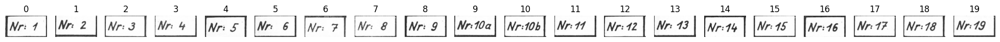

In [60]:
fig, axs = plt.subplots(1, 20, figsize=(25, 5))
for idx, ax in enumerate(axs):
    ax.imshow(nr_images[idx], cmap='gray', vmin=0, vmax=1)
    ax.axis('off')
    ax.set_title(f'{idx}')
plt.show()

In [61]:
N = 1

In [62]:
nr_images[N].shape

(92, 180)

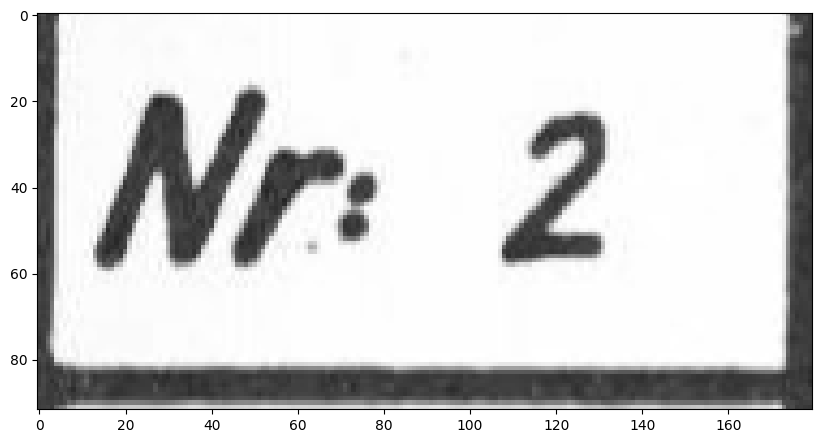

In [63]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
axs.imshow(nr_images[N], cmap='gray', vmin=0, vmax=1)
plt.show()

In [71]:
res, text = generate_description(nr_images[N], model, processor, SYSTEM_MESSAGE_NUMBER, scale_factor=inference_scale_factor)

In [72]:
res

'Nr: 2'

### Now get all the cells

Start by listing all the observations that will make up the table

In [73]:
observations = list(species_phases_dicts.keys())

In [74]:
observations

['number',
 'location',
 'county',
 'position',
 'hasl',
 'ds',
 'coltsfoot_flowering',
 'coltsfoot_fruit',
 'coltsfoot_timespan',
 'liverleaf_fruit',
 'liverleaf_timespan',
 'wood_anemone_flowering',
 'wood_anemone_fruit',
 'wood_anemone_timespan',
 'purple_saxifrage_flowering',
 'purple_saxifrage_fruit',
 'purple_saxifrage_timespan',
 'meadow_saxifrage_flowering',
 'meadow_saxifrage_fruit',
 'meadow_saxifrage_timespan',
 'cowslip_flowering',
 'cowslip_fruit',
 'cowslip_timespan',
 'marsh_marigold_flowering',
 'marsh_marigold_fruit',
 'marsh_marigold_timespan',
 'globeflower_flowering',
 'globeflower_fruit',
 'globeflower_timespan',
 'lily_of_the_valley_flowering',
 'lily_of_the_valley_fruit',
 'lily_of_the_valley_timespan',
 'wild_strawberry_flowering',
 'wild_strawberry_fruit',
 'wild_strawberry_timespan',
 'wood_sorrel_flowering',
 'wood_sorrel_fruit',
 'wood_sorrel_timespan',
 'arctic_starflower_flowering',
 'arctic_starflower_fruit',
 'arctic_starflower_timespan',
 'linnaea_flowe

In [95]:
columns = []

for observation in observations:
    columns.append(f'{observation}')
    columns.append(f'{observation}_image')

phenology_df = pd.DataFrame(columns=columns)

In [96]:
phenology_df.columns

Index(['number', 'number_image', 'location', 'location_image', 'county',
       'county_image', 'position', 'position_image', 'hasl', 'hasl_image',
       ...
       'barley_ripe_for_harvesting', 'barley_ripe_for_harvesting_image',
       'barley_maturing_time', 'barley_maturing_time_image',
       'wheat_ripe_for_harvesting', 'wheat_ripe_for_harvesting_image',
       'wheat_maturing_time', 'wheat_maturing_time_image',
       'percentage_of_unripe_wheat', 'percentage_of_unripe_wheat_image'],
      dtype='object', length=592)

In [97]:
phenology_df.head(50)

,number,number_image,location,location_image,county,county_image,position,position_image,hasl,hasl_image,...,barley_ripe_for_harvesting,barley_ripe_for_harvesting_image,barley_maturing_time,barley_maturing_time_image,wheat_ripe_for_harvesting,wheat_ripe_for_harvesting_image,wheat_maturing_time,wheat_maturing_time_image,percentage_of_unripe_wheat,percentage_of_unripe_wheat_image


In [ ]:
idx = 0
tmp_tables = tables[:3]
total_tables = len(tmp_tables)
total_observations = len(observations)
obs_counter = 1  # Flat counter across all table-observation pairs

for table_idx, table in enumerate(tqdm(tmp_tables, desc='Processing tables', total=total_tables)):
    
    for obs_idx, observation in enumerate(observations):
        # Build and print status line with fixed width
        status_line = f"  └─ Processing observation: '{observation}' ({obs_counter} of {total_observations})"
        print(status_line.ljust(120), end='\r')  # Padding to prevent leftover characters

        # Extract images
        if observation in ['position', 'hasl', 'ds']:
            images = show_selection([page],
                                    species_phases_dicts[observation],
                                    offset=7,
                                    rotate=True,
                                    selem_size=SELEM_SIZE,
                                    selection_size=None,
                                    show_images=False)
        else:
            images = show_selection([page],
                                    species_phases_dicts[observation],
                                    offset=7,
                                    rotate=False,
                                    selem_size=SELEM_SIZE,
                                    selection_size=None,
                                    show_images=False)

        for image in images:
            english_name = species_phases_dicts[observation]['english_name']

            if english_name == 'Number':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_NUMBER, scale_factor=inference_scale_factor)
                phenology_df.loc[table_idx, 'number'] = re.sub(r'^Nr:\s*', '', res)
                phenology_df.loc[table_idx, 'number_image'] = img_to_bytes(image)
            elif english_name == 'Location':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_LOCATION, scale_factor=inference_scale_factor)
                phenology_df.loc[table_idx, 'location'] = re.sub(r'^Ort:\s*', '', res)
                phenology_df.loc[table_idx, 'location_image'] = img_to_bytes(image)
            elif english_name == 'County':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_COUNTY, scale_factor=inference_scale_factor)
                phenology_df.loc[table_idx, 'county'] = re.sub(r'^Fylke:\s*', '', res)
                phenology_df.loc[table_idx, 'county_image'] = img_to_bytes(image)
            elif english_name == 'Position':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_POSITION, scale_factor=inference_scale_factor)
                lat, lon = parse_coordinates(res)
                phenology_df.loc[table_idx, 'position'] = f'{lat:.4f}, {lon:.4f}'
                phenology_df.loc[table_idx, 'position_image'] = img_to_bytes(image)
            elif english_name == 'HASL':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_HASL, scale_factor=inference_scale_factor)
                match = re.match(r'.*H\s*=\s*\({0,1}(\d{1,})\){0,1}\s*m.*', res)
                phenology_df.loc[table_idx, 'hasl'] = match.group(1) if match else None
            elif english_name == 'DS':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_DS, scale_factor=inference_scale_factor)
                match = re.match(r'.*K\s*=\s*(\d{1,4})', res)
                phenology_df.loc[table_idx, 'ds'] = match.group(1) if match else None
            else:
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_PHENOLOGY, scale_factor=inference_scale_factor)
                phenology_df.loc[table_idx, f'{observation}'] = res
                phenology_df.loc[table_idx, f'{observation}_image'] = img_to_bytes(image)

        obs_counter += 1  # Increment after every observation per table

    obs_counter = 0

Processing tables:   0%|          | 0/3 [00:00<?, ?it/s]

Processing tables:  33%|███▎      | 1/3 [10:54<21:49, 654.75s/it]

Processing tables:  67%|██████▋   | 2/3 [18:36<09:01, 541.33s/it]

In [121]:
phenology_df.to_pickle('../Data/processed/phenology_df.pkl')

In [94]:
phenology_df.head(50)

,number,number_image,location,location_image,county,county_image,position,position_image,hasl,hasl_image,...,barley_ripe_for_harvesting,barley_ripe_for_harvesting_image,barley_maturing_time,barley_maturing_time_image,wheat_ripe_for_harvesting,wheat_ripe_for_harvesting_image,wheat_maturing_time,wheat_maturing_time_image,percentage_of_unripe_wheat,percentage_of_unripe_wheat_image
0,259,"b""II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...",Spydeberg,"b""II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...",Φ23,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,"59.0833, 11.0000",b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,115,NaN,...,236,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,93,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,247,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,110,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,%,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...
1,259,"b""II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...",Spydeberg,"b""II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...",Φ23,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,"59.0833, 11.0000",b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,115,NaN,...,236,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,93,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,247,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,110,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,%,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...
2,259,"b""II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...",Spydeberg,"b""II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...",Ø23,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,"59.0833, 11.0000",b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,115,NaN,...,236,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,93,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,247,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,110,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...,%,b'II*\x00\x08\x00\x00\x00\t\x00\x00\x01\x04\x0...


In [ ]:
phenology_df[[col for col in phenology_df.columns if '_image' not in col]]

In [ ]:
tmp_img = bytes_to_img(phenology_df.loc[42, 'marsh_marigold_fruit_image'])
tmp_img

### Some test plots

In [ ]:
# Try loading from a different Natural Earth URL
url = "https://raw.githubusercontent.com/nvkelso/natural-earth-vector/master/geojson/ne_110m_admin_0_countries.geojson"
world = gpd.read_file(url)
norway = world[world['NAME'] == 'Norway']  # or world[world['ADMIN'] == 'Norway']

In [ ]:
positions = [row['position'].split(',') for _, row in phenology_df[['position']].dropna().iterrows()]
positions

In [ ]:
locations = [x[0] for x in phenology_df[['location']].dropna().values]
locations

In [145]:
def convert_to_decimal(deg_min):
    deg_min = deg_min.strip()  # Remove any extra spaces
    parts = deg_min.split('.')
    degrees = int(parts[0])
    minutes = int(parts[1]) if len(parts) > 1 else 0
    decimal_degrees = degrees + minutes/60
    return decimal_degrees

In [146]:
import folium
from folium.plugins import MarkerCluster

# Create DataFrame with converted coordinates
data = []
for i, pos in enumerate(positions):
    lat = convert_to_decimal(pos[0])
    lon = convert_to_decimal(pos[1])
    data.append({
        'name': locations[i],
        'lat': lat,
        'lon': lon
    })

df = pd.DataFrame(data)

# Create map centered on Norway
map_norway = folium.Map(
    location=[65.0, 15.0],
    zoom_start=5,
    tiles='CartoDB Positron'
)

# Add different tile options with proper attribution
folium.TileLayer('CartoDB Dark_Matter').add_to(map_norway)
folium.TileLayer('OpenStreetMap').add_to(map_norway)
folium.TileLayer(
    'Stamen Terrain', 
    attr='Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL'
).add_to(map_norway)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(map_norway)

# Add markers to the cluster
for i, row in df.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        popup=f"<strong>{row['name']}</strong><br>Lat: {row['lat']:.4f}, Lon: {row['lon']:.4f}",
        tooltip=row['name']
    ).add_to(marker_cluster)

# Add layer control
folium.LayerControl().add_to(map_norway)

# Save the map
map_norway.save('norway_locations_map.html')